In [1]:
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.resnet50 import decode_predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import json
import cv2
import random
import sys
import os
import torch

# Get the absolute path of the src folder

sys.path.append(os.path.abspath("../src"))

from utils_attack import compute_psnr, compute_ssim, compute_msssim, eval_psnr_ssim_msssim, bytearray_to_bits
from regen_pipe import ReSDPipeline
from regen_attack import DiffWMAttacker


2025-03-09 14:37:23.275429: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-09 14:37:23.275485: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-09 14:37:23.277123: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-09 14:37:23.292387: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
wm_text = 'test'
device = 'cuda:0'
print_width = 50

In [3]:
pipe = ReSDPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16, variant="fp16")
pipe.set_progress_bar_config(disable=True)
pipe.to(device)
print('Finished loading model')

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/681M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/939 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/1.73G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Finished loading model


In [4]:
from blackbox import verify_watermark

2025-03-08 21:42:16.571404: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 7990 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:b2:00.0, compute capability: 6.1


In [5]:
from src.utils_blackbox import show_image, preprocess_image, clip_eps, get_label, plot_combined_histogram


In [6]:
attackers = {
    'diff_attacker_60': DiffWMAttacker(pipe, batch_size=5, noise_step=60, captions={})
}

Diffuse attack initialized with noise step 60 and use prompt 0


In [6]:
attacker_name = "diff_attacker_60"
attacker = attackers[attacker_name]   # Select the attacker

print('*' * print_width)
print(f'Attacking PGD Blackbox Watermark with {attacker_name}')

# Define paths for the input and output of the attack
watermarked_img_path = "../output/blackbox_epsilon_testing/epsilon_7.jpg"  # Input image
# watermarked_img_path = "examples/panda.jpg"
attacked_img_path = "../output/original_panda_attacked.jpg"

# Move attacker model to CUDA if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
attacker.pipe.to(device)  # Ensure the model is on the right device

# Apply the attack
attacker.attack([watermarked_img_path], [attacked_img_path])

print('Finished attacking')


**************************************************
Attacking PGD Blackbox Watermark with diff_attacker_60


1it [00:00,  1.32it/s]
/home/apurohit/.local/lib/python3.11/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:283: FutureWarning: `_encode_prompt()` is deprecated and it will be removed in a future version. Use `encode_prompt()` instead. Also, be aware that the output format changed from a concatenated tensor to a tuple.
  deprecate("_encode_prompt()", "1.0.0", deprecation_message, standard_warn=False)


Finished attacking


/home/apurohit/.local/lib/python3.11/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:569: FutureWarning: The decode_latents method is deprecated and will be removed in 1.0.0. Please use VaeImageProcessor.postprocess(...) instead
  deprecate("decode_latents", "1.0.0", deprecation_message, standard_warn=False)


In [7]:
resnet50 = tf.keras.applications.ResNet50(weights="imagenet", include_top=True, classifier_activation=None)


In [8]:
original_image_path = "../examples/panda.jpg"
attacked_img_path = "../output/original_panda_attacked.jpg"


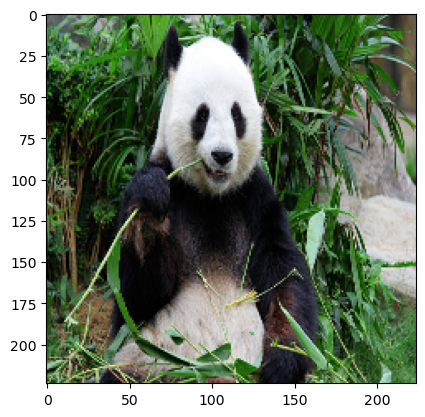

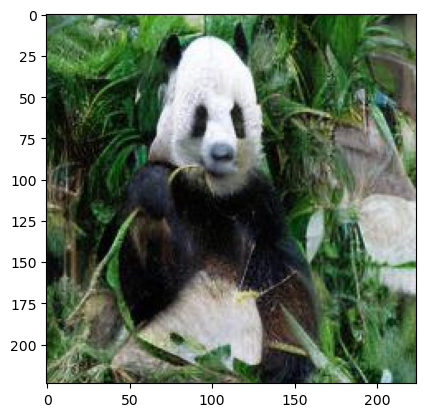

2025-03-06 16:00:43.298382: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


1/1 [==============================] - 0s 39ms/step


In [11]:
sample_image_org = show_image(original_image_path)
preprocessed_image_org = preprocess_image(sample_image_org)
image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)

sample_image_att = show_image(attacked_img_path)
preprocessed_image = preprocess_image(sample_image_att)
image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)

original_logits = resnet50.predict(preprocess_input(image_tensor_org))
attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

In [12]:
verify_watermark(original_logits, attacked_logits, [726, 264, 428, 190])

Label: 726 | Logit Before: -3.12917 | Logit After: -2.24430 | Logit Diff: 0.88487
Label: 264 | Logit Before: 3.17343 | Logit After: 1.76908 | Logit Diff: -1.40435
Label: 428 | Logit Before: 4.07258 | Logit After: 3.22958 | Logit Diff: -0.84300
Label: 190 | Logit Before: 1.40211 | Logit After: 2.83841 | Logit Diff: 1.43630
Average Logit Difference: 0.01845
Positive Percentage: 50.00%
Verification Status: Verified


(True, 0.018454700708389282)

Processing image: epsilon_14.jpg
14
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 67.48it/s]


Finished attacking: epsilon_14.jpg


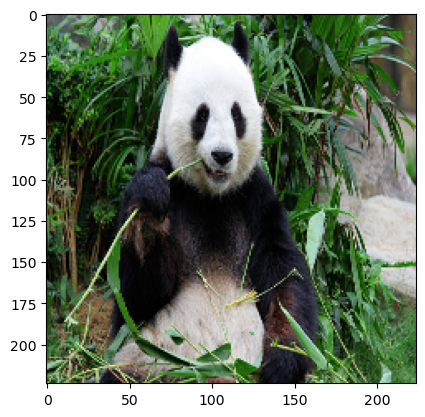

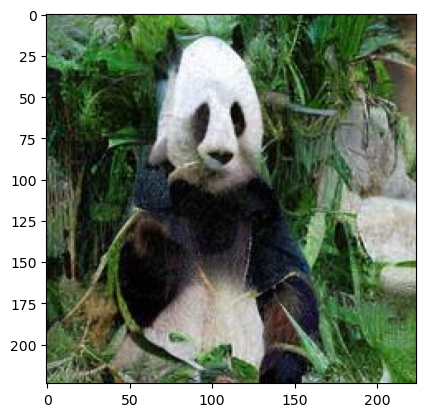

1/1 [==============================] - 0s 47ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.28707 | Logit Diff: 1.84210
Label: 264 | Logit Before: 3.17343 | Logit After: 3.03683 | Logit Diff: -0.13660
Label: 428 | Logit Before: 4.07258 | Logit After: 3.36566 | Logit Diff: -0.70692
Label: 190 | Logit Before: 1.40211 | Logit After: 4.22088 | Logit Diff: 2.81877
Average Logit Difference: 0.95434
Positive Percentage: 50.00%
Verification Status: Verified
True
0.9543380439281464
Processing image: epsilon_1.jpg
1
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 12.95it/s]


Finished attacking: epsilon_1.jpg


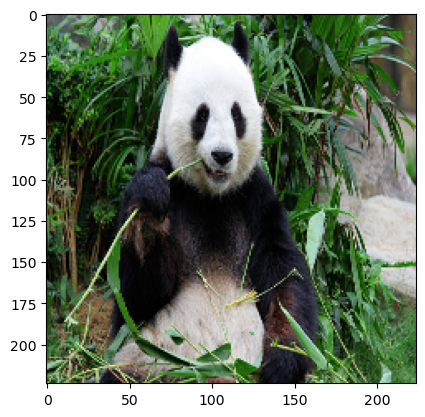

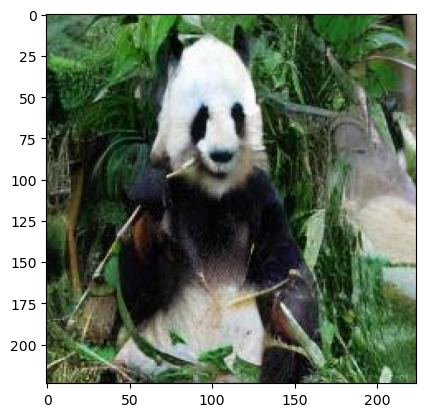

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -0.65236 | Logit Diff: 2.47681
Label: 264 | Logit Before: 3.17343 | Logit After: 1.83822 | Logit Diff: -1.33522
Label: 428 | Logit Before: 4.07258 | Logit After: 4.11138 | Logit Diff: 0.03880
Label: 190 | Logit Before: 1.40211 | Logit After: 6.01081 | Logit Diff: 4.60870
Average Logit Difference: 1.44727
Positive Percentage: 75.00%
Verification Status: Verified
True
1.4472721219062805
Processing image: epsilon_13.jpg
13
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00,  4.69it/s]


Finished attacking: epsilon_13.jpg


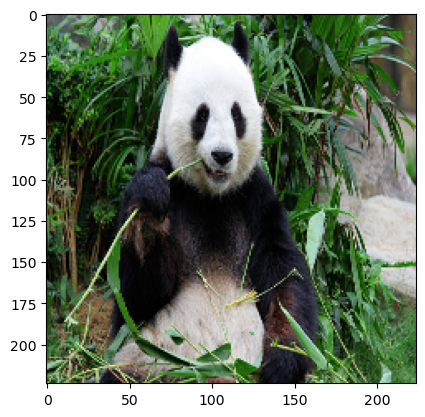

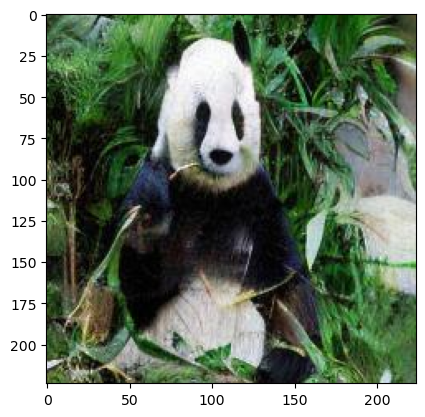

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.85319 | Logit Diff: 1.27598
Label: 264 | Logit Before: 3.17343 | Logit After: 2.37339 | Logit Diff: -0.80005
Label: 428 | Logit Before: 4.07258 | Logit After: 2.74685 | Logit Diff: -1.32572
Label: 190 | Logit Before: 1.40211 | Logit After: 2.86430 | Logit Diff: 1.46219
Average Logit Difference: 0.15310
Positive Percentage: 50.00%
Verification Status: Verified
True
0.15309879183769226
Processing image: epsilon_6.jpg
6
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 11.25it/s]


Finished attacking: epsilon_6.jpg


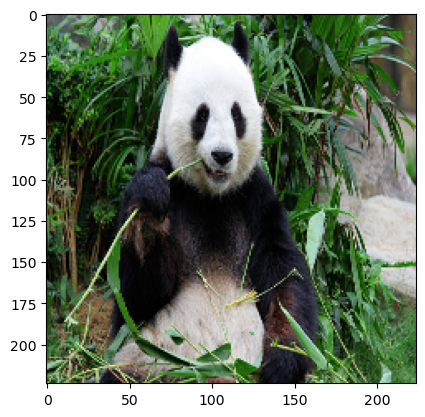

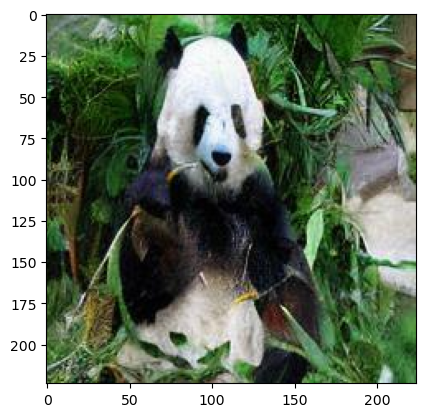

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.11955 | Logit Diff: 1.00962
Label: 264 | Logit Before: 3.17343 | Logit After: 3.23184 | Logit Diff: 0.05840
Label: 428 | Logit Before: 4.07258 | Logit After: 3.28583 | Logit Diff: -0.78675
Label: 190 | Logit Before: 1.40211 | Logit After: 4.49449 | Logit Diff: 3.09238
Average Logit Difference: 0.84341
Positive Percentage: 75.00%
Verification Status: Verified
True
0.8434111475944519
Processing image: epsilon_8.jpg
8
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00,  8.52it/s]


Finished attacking: epsilon_8.jpg


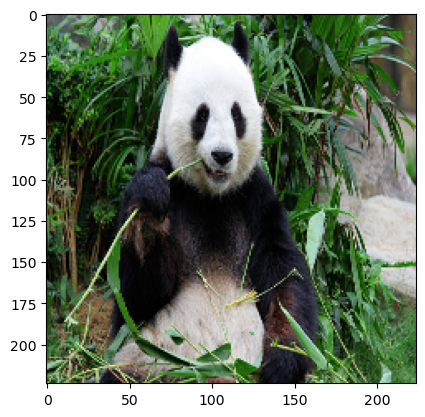

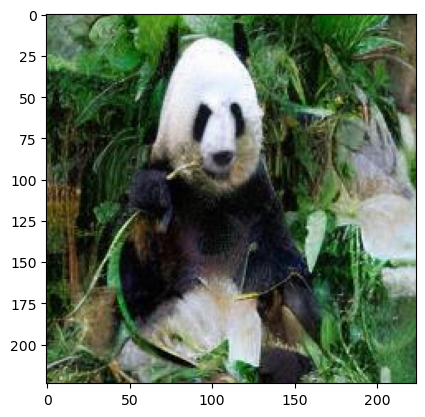

1/1 [==============================] - 0s 39ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.96372 | Logit Diff: 1.16545
Label: 264 | Logit Before: 3.17343 | Logit After: 2.49043 | Logit Diff: -0.68300
Label: 428 | Logit Before: 4.07258 | Logit After: 3.21362 | Logit Diff: -0.85896
Label: 190 | Logit Before: 1.40211 | Logit After: 3.27891 | Logit Diff: 1.87680
Average Logit Difference: 0.37507
Positive Percentage: 50.00%
Verification Status: Verified
True
0.3750695288181305
Processing image: epsilon_28.jpg
28
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 86.37it/s]


Finished attacking: epsilon_28.jpg


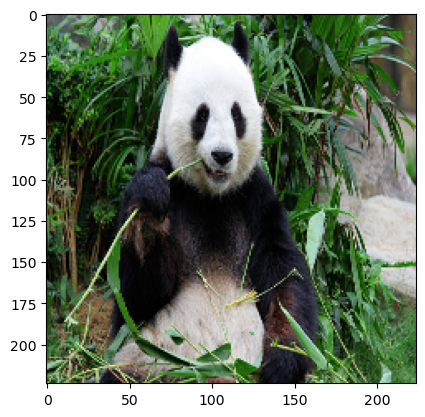

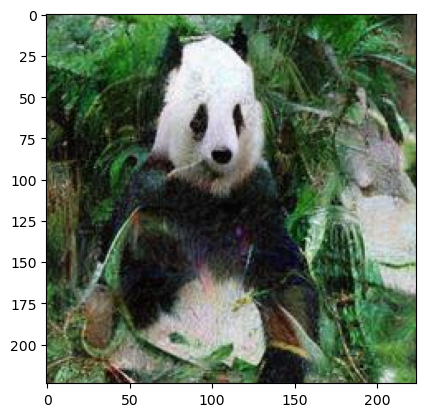

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.52255 | Logit Diff: -0.39338
Label: 264 | Logit Before: 3.17343 | Logit After: 1.64641 | Logit Diff: -1.52702
Label: 428 | Logit Before: 4.07258 | Logit After: 3.59997 | Logit Diff: -0.47260
Label: 190 | Logit Before: 1.40211 | Logit After: 5.86811 | Logit Diff: 4.46599
Average Logit Difference: 0.51825
Positive Percentage: 25.00%
Verification Status: Not Verified
False
0.5182470083236694
Processing image: epsilon_26.jpg
26
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 43.99it/s]


Finished attacking: epsilon_26.jpg


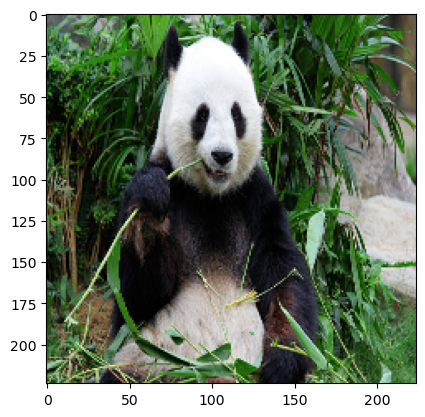

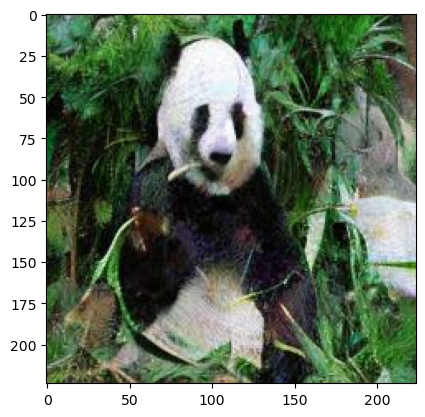

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.31720 | Logit Diff: -0.18804
Label: 264 | Logit Before: 3.17343 | Logit After: 3.09707 | Logit Diff: -0.07636
Label: 428 | Logit Before: 4.07258 | Logit After: 4.09576 | Logit Diff: 0.02318
Label: 190 | Logit Before: 1.40211 | Logit After: 5.24709 | Logit Diff: 3.84498
Average Logit Difference: 0.90094
Positive Percentage: 50.00%
Verification Status: Verified
True
0.9009405374526978
Processing image: epsilon_21.jpg
21
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 85.45it/s]


Finished attacking: epsilon_21.jpg


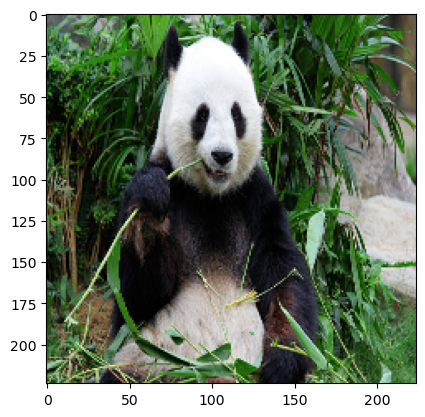

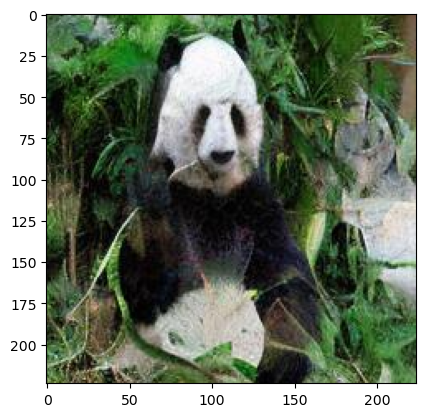

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.23294 | Logit Diff: 0.89623
Label: 264 | Logit Before: 3.17343 | Logit After: 3.54880 | Logit Diff: 0.37536
Label: 428 | Logit Before: 4.07258 | Logit After: 4.06476 | Logit Diff: -0.00782
Label: 190 | Logit Before: 1.40211 | Logit After: 3.88237 | Logit Diff: 2.48026
Average Logit Difference: 0.93601
Positive Percentage: 75.00%
Verification Status: Verified
True
0.936007022857666
Processing image: epsilon_30.jpg
30
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 51.74it/s]


Finished attacking: epsilon_30.jpg


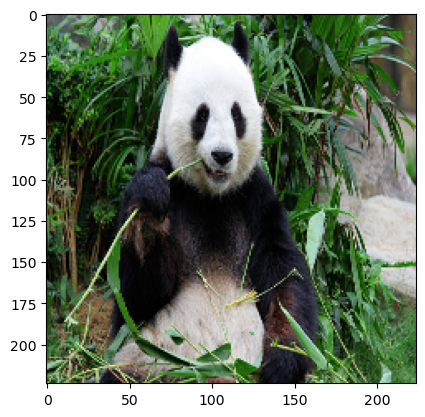

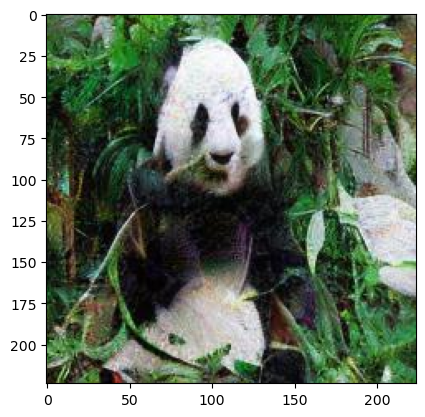

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.05556 | Logit Diff: 1.07361
Label: 264 | Logit Before: 3.17343 | Logit After: 3.63482 | Logit Diff: 0.46139
Label: 428 | Logit Before: 4.07258 | Logit After: 3.37786 | Logit Diff: -0.69472
Label: 190 | Logit Before: 1.40211 | Logit After: 3.75548 | Logit Diff: 2.35337
Average Logit Difference: 0.79841
Positive Percentage: 75.00%
Verification Status: Verified
True
0.7984133958816528
Processing image: epsilon_37.jpg
37
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 20.51it/s]


Finished attacking: epsilon_37.jpg


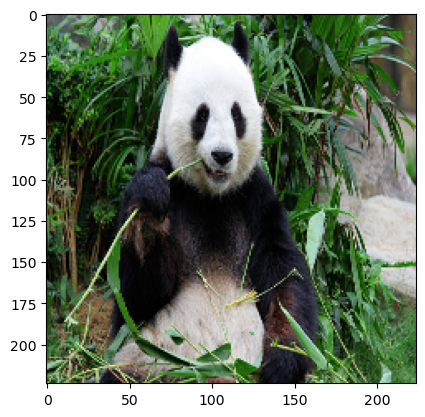

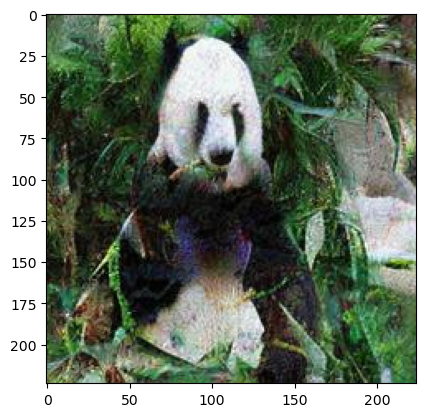

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.94681 | Logit Diff: 0.18236
Label: 264 | Logit Before: 3.17343 | Logit After: 1.29963 | Logit Diff: -1.87381
Label: 428 | Logit Before: 4.07258 | Logit After: 3.29626 | Logit Diff: -0.77632
Label: 190 | Logit Before: 1.40211 | Logit After: 3.18943 | Logit Diff: 1.78731
Average Logit Difference: -0.17011
Positive Percentage: 50.00%
Verification Status: Verified
True
-0.17011407017707825
Processing image: epsilon_39.jpg
39
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 103.59it/s]


Finished attacking: epsilon_39.jpg


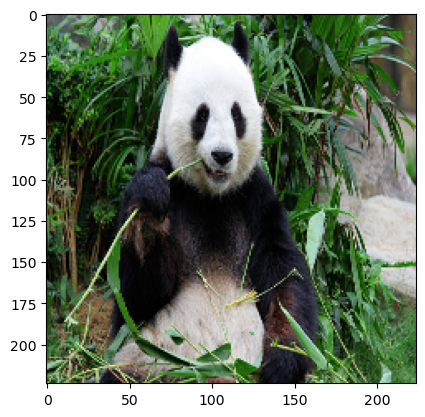

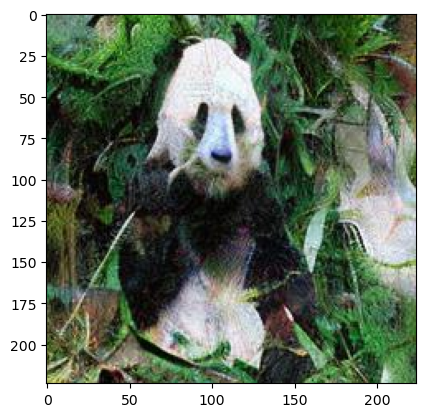

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.45883 | Logit Diff: 1.67033
Label: 264 | Logit Before: 3.17343 | Logit After: 1.96052 | Logit Diff: -1.21291
Label: 428 | Logit Before: 4.07258 | Logit After: 3.25304 | Logit Diff: -0.81953
Label: 190 | Logit Before: 1.40211 | Logit After: 3.20072 | Logit Diff: 1.79861
Average Logit Difference: 0.35912
Positive Percentage: 50.00%
Verification Status: Verified
True
0.3591245710849762
Processing image: epsilon_20.jpg
20
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 91.27it/s]


Finished attacking: epsilon_20.jpg


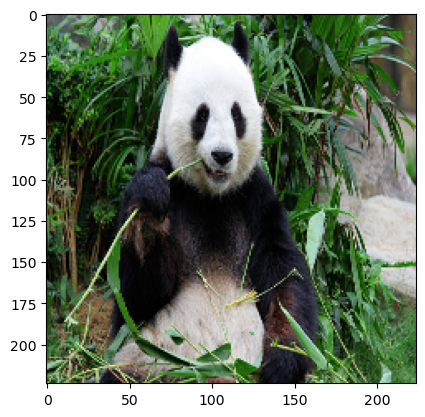

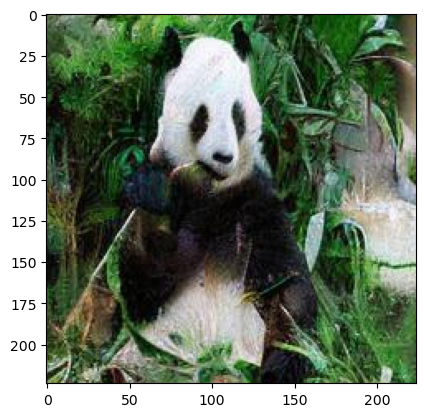

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.75671 | Logit Diff: 1.37246
Label: 264 | Logit Before: 3.17343 | Logit After: 3.65798 | Logit Diff: 0.48454
Label: 428 | Logit Before: 4.07258 | Logit After: 3.58706 | Logit Diff: -0.48552
Label: 190 | Logit Before: 1.40211 | Logit After: 3.68353 | Logit Diff: 2.28142
Average Logit Difference: 0.91323
Positive Percentage: 75.00%
Verification Status: Verified
True
0.9132265150547028
Processing image: epsilon_27.jpg
27
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 99.26it/s]


Finished attacking: epsilon_27.jpg


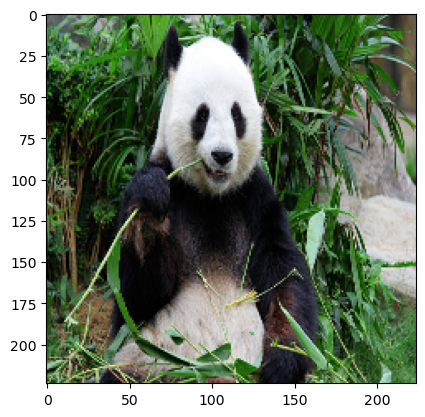

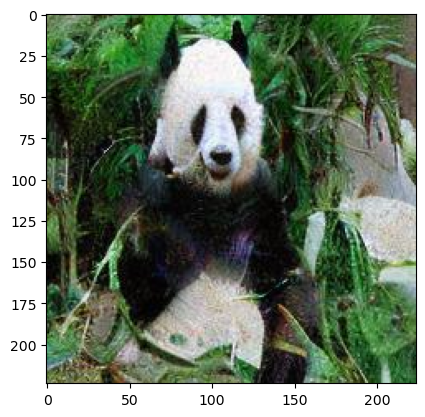

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.15120 | Logit Diff: -0.02203
Label: 264 | Logit Before: 3.17343 | Logit After: 1.08001 | Logit Diff: -2.09343
Label: 428 | Logit Before: 4.07258 | Logit After: 4.22101 | Logit Diff: 0.14844
Label: 190 | Logit Before: 1.40211 | Logit After: 5.32791 | Logit Diff: 3.92580
Average Logit Difference: 0.48969
Positive Percentage: 50.00%
Verification Status: Verified
True
0.48969393968582153
Processing image: epsilon_29.jpg
29
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 105.65it/s]


Finished attacking: epsilon_29.jpg


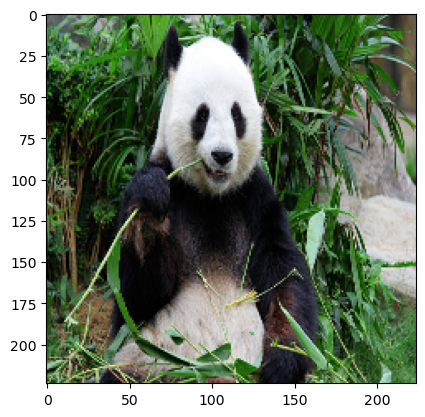

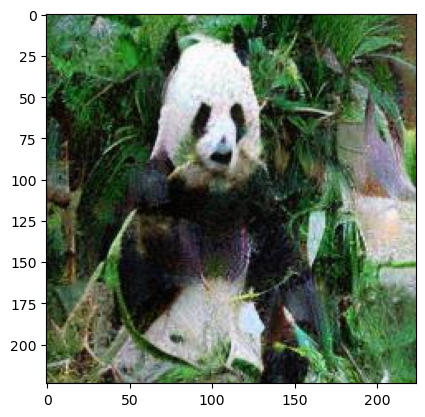

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.07813 | Logit Diff: 1.05104
Label: 264 | Logit Before: 3.17343 | Logit After: 3.27805 | Logit Diff: 0.10461
Label: 428 | Logit Before: 4.07258 | Logit After: 3.63952 | Logit Diff: -0.43306
Label: 190 | Logit Before: 1.40211 | Logit After: 5.03001 | Logit Diff: 3.62790
Average Logit Difference: 1.08762
Positive Percentage: 75.00%
Verification Status: Verified
True
1.0876237154006958
Processing image: epsilon_9.jpg
9
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 16.42it/s]


Finished attacking: epsilon_9.jpg


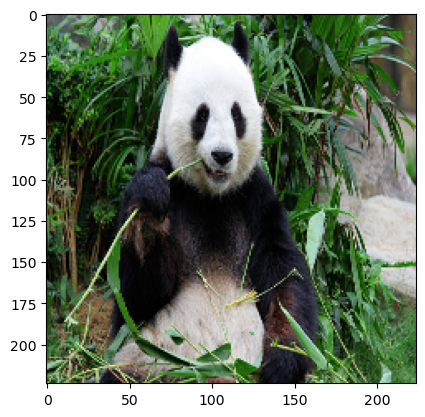

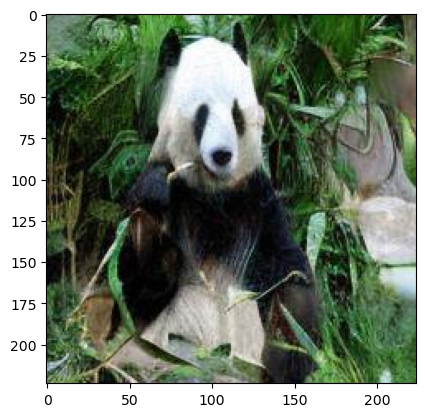

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.39882 | Logit Diff: 0.73034
Label: 264 | Logit Before: 3.17343 | Logit After: 4.03180 | Logit Diff: 0.85837
Label: 428 | Logit Before: 4.07258 | Logit After: 3.92895 | Logit Diff: -0.14363
Label: 190 | Logit Before: 1.40211 | Logit After: 3.78074 | Logit Diff: 2.37863
Average Logit Difference: 0.95593
Positive Percentage: 75.00%
Verification Status: Verified
True
0.955928385257721
Processing image: epsilon_12.jpg
12
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00,  7.06it/s]


Finished attacking: epsilon_12.jpg


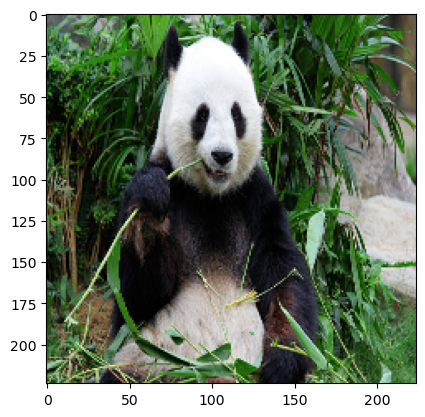

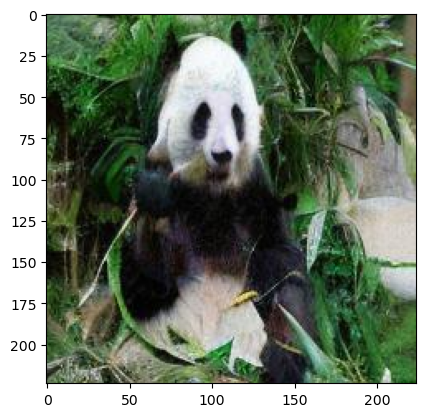

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.78835 | Logit Diff: 0.34082
Label: 264 | Logit Before: 3.17343 | Logit After: 3.22350 | Logit Diff: 0.05007
Label: 428 | Logit Before: 4.07258 | Logit After: 4.36421 | Logit Diff: 0.29163
Label: 190 | Logit Before: 1.40211 | Logit After: 3.90042 | Logit Diff: 2.49830
Average Logit Difference: 0.79521
Positive Percentage: 100.00%
Verification Status: Verified
True
0.7952066659927368
Processing image: epsilon_7.jpg
7
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 101.80it/s]


Finished attacking: epsilon_7.jpg


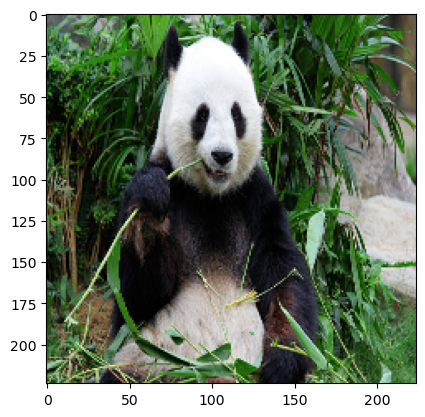

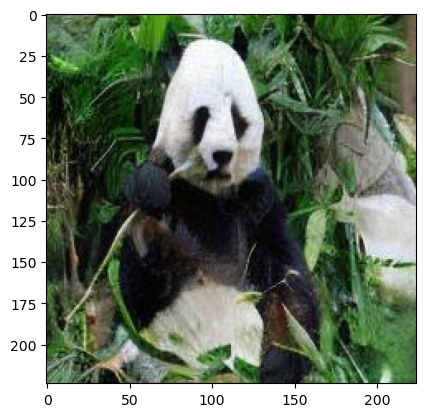

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.28672 | Logit Diff: 1.84245
Label: 264 | Logit Before: 3.17343 | Logit After: 3.12690 | Logit Diff: -0.04654
Label: 428 | Logit Before: 4.07258 | Logit After: 4.07630 | Logit Diff: 0.00373
Label: 190 | Logit Before: 1.40211 | Logit After: 2.52143 | Logit Diff: 1.11931
Average Logit Difference: 0.72974
Positive Percentage: 75.00%
Verification Status: Verified
True
0.7297382354736328
Processing image: epsilon_15.jpg
15
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 100.31it/s]


Finished attacking: epsilon_15.jpg


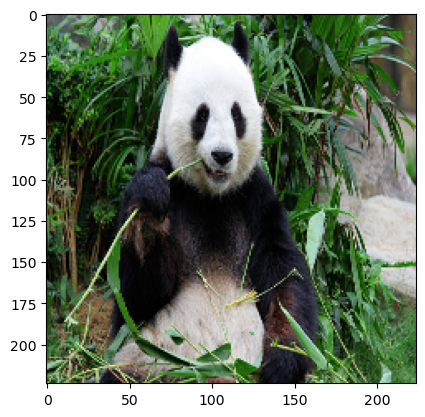

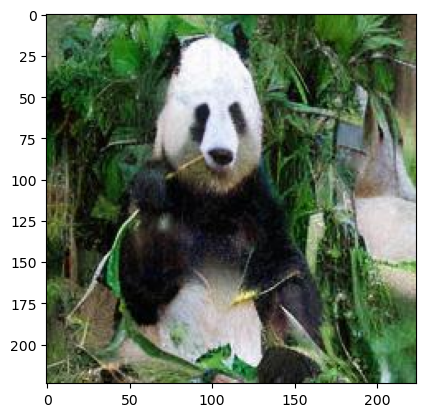

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.12706 | Logit Diff: 1.00211
Label: 264 | Logit Before: 3.17343 | Logit After: 3.22673 | Logit Diff: 0.05330
Label: 428 | Logit Before: 4.07258 | Logit After: 3.96567 | Logit Diff: -0.10691
Label: 190 | Logit Before: 1.40211 | Logit After: 3.18049 | Logit Diff: 1.77838
Average Logit Difference: 0.68172
Positive Percentage: 75.00%
Verification Status: Verified
True
0.6817198395729065
Processing image: epsilon_38.jpg
38
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 94.60it/s]


Finished attacking: epsilon_38.jpg


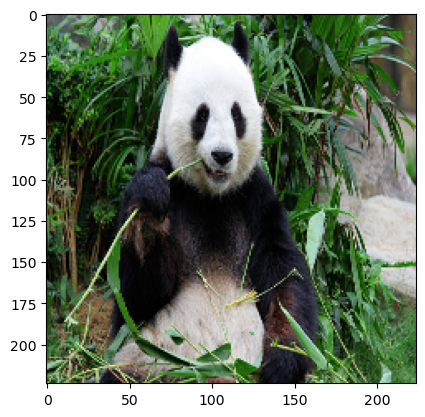

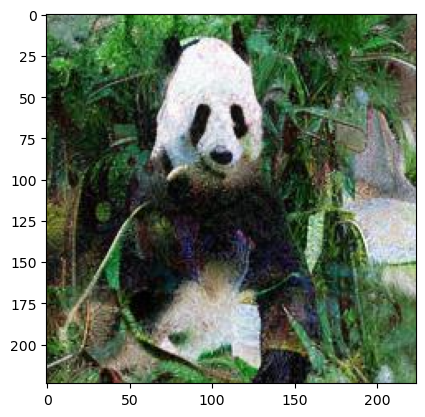

1/1 [==============================] - 0s 31ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.05208 | Logit Diff: 0.07708
Label: 264 | Logit Before: 3.17343 | Logit After: 2.15428 | Logit Diff: -1.01916
Label: 428 | Logit Before: 4.07258 | Logit After: 3.69833 | Logit Diff: -0.37425
Label: 190 | Logit Before: 1.40211 | Logit After: 4.35283 | Logit Diff: 2.95072
Average Logit Difference: 0.40860
Positive Percentage: 50.00%
Verification Status: Verified
True
0.4085996747016907
Processing image: epsilon_36.jpg
36
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00,  2.98it/s]


Finished attacking: epsilon_36.jpg


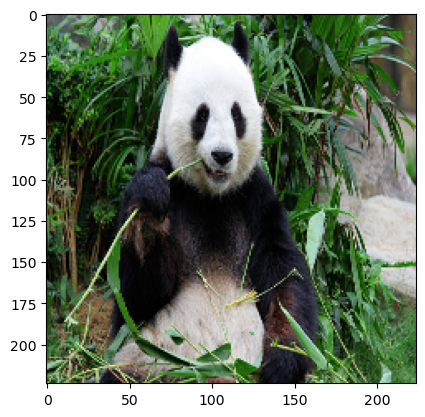

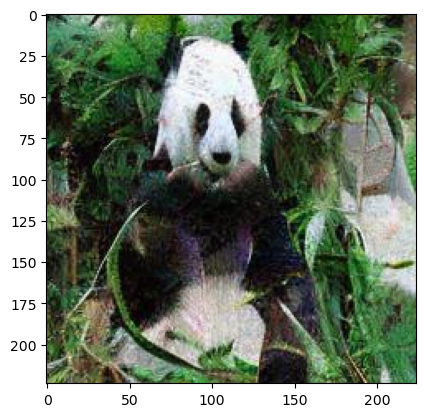

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.74353 | Logit Diff: 0.38564
Label: 264 | Logit Before: 3.17343 | Logit After: 3.14096 | Logit Diff: -0.03248
Label: 428 | Logit Before: 4.07258 | Logit After: 3.71714 | Logit Diff: -0.35544
Label: 190 | Logit Before: 1.40211 | Logit After: 7.31861 | Logit Diff: 5.91650
Average Logit Difference: 1.47856
Positive Percentage: 50.00%
Verification Status: Verified
True
1.4785563349723816
Processing image: epsilon_31.jpg
31
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 102.54it/s]


Finished attacking: epsilon_31.jpg


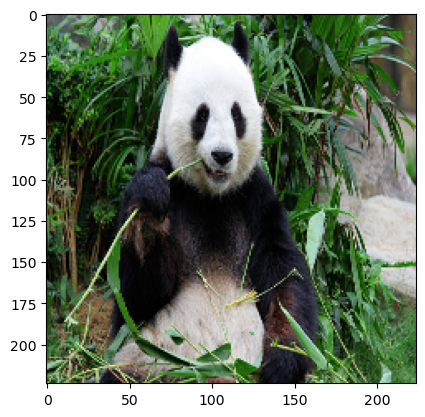

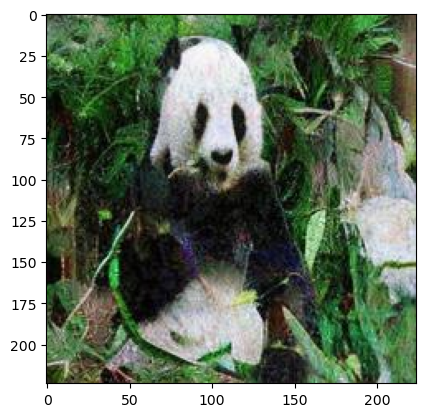

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.61057 | Logit Diff: 1.51860
Label: 264 | Logit Before: 3.17343 | Logit After: 1.82836 | Logit Diff: -1.34508
Label: 428 | Logit Before: 4.07258 | Logit After: 2.85259 | Logit Diff: -1.21998
Label: 190 | Logit Before: 1.40211 | Logit After: 4.41031 | Logit Diff: 3.00820
Average Logit Difference: 0.49044
Positive Percentage: 50.00%
Verification Status: Verified
True
0.4904358386993408
Processing image: epsilon_40.jpg
40
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 105.89it/s]


Finished attacking: epsilon_40.jpg


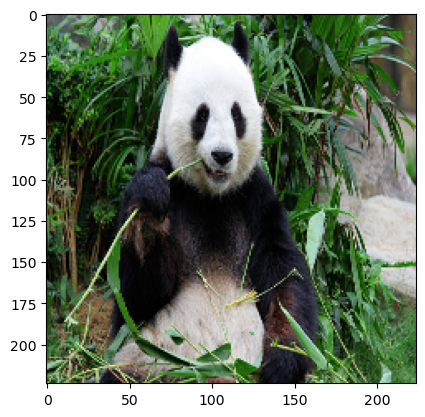

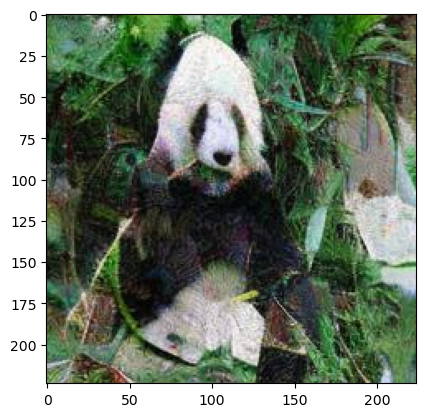

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.96798 | Logit Diff: 0.16119
Label: 264 | Logit Before: 3.17343 | Logit After: 1.83240 | Logit Diff: -1.34103
Label: 428 | Logit Before: 4.07258 | Logit After: 3.60831 | Logit Diff: -0.46426
Label: 190 | Logit Before: 1.40211 | Logit After: 5.30915 | Logit Diff: 3.90704
Average Logit Difference: 0.56573
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5657340288162231
Processing image: epsilon_32.jpg
32
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 17.86it/s]


Finished attacking: epsilon_32.jpg


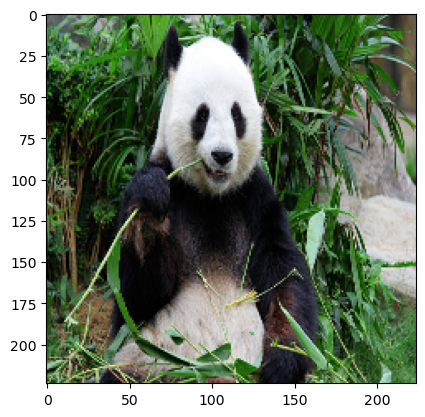

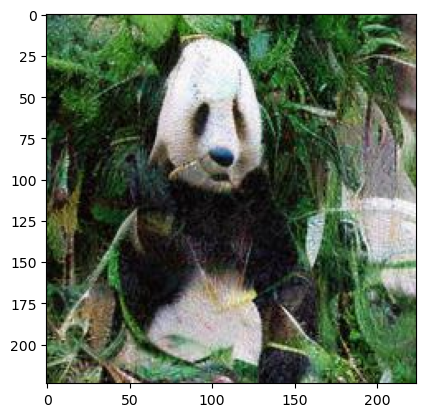

1/1 [==============================] - 0s 90ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.37913 | Logit Diff: 0.75004
Label: 264 | Logit Before: 3.17343 | Logit After: 2.47783 | Logit Diff: -0.69560
Label: 428 | Logit Before: 4.07258 | Logit After: 3.92250 | Logit Diff: -0.15008
Label: 190 | Logit Before: 1.40211 | Logit After: 2.98640 | Logit Diff: 1.58429
Average Logit Difference: 0.37216
Positive Percentage: 50.00%
Verification Status: Verified
True
0.3721616864204407
Processing image: epsilon_35.jpg
35
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 91.52it/s]


Finished attacking: epsilon_35.jpg


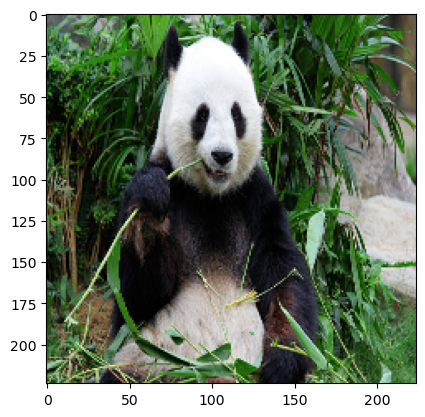

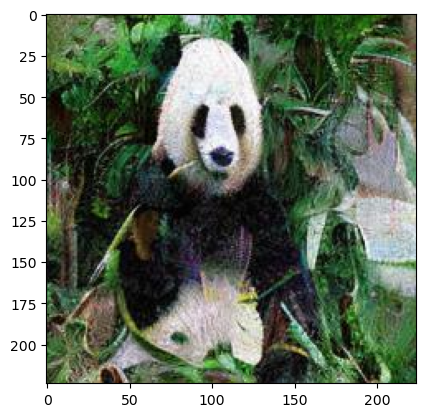

1/1 [==============================] - 0s 39ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.17976 | Logit Diff: 0.94941
Label: 264 | Logit Before: 3.17343 | Logit After: 2.17831 | Logit Diff: -0.99512
Label: 428 | Logit Before: 4.07258 | Logit After: 3.63754 | Logit Diff: -0.43504
Label: 190 | Logit Before: 1.40211 | Logit After: 3.29514 | Logit Diff: 1.89303
Average Logit Difference: 0.35307
Positive Percentage: 50.00%
Verification Status: Verified
True
0.35306936502456665
Processing image: epsilon_24.jpg
24
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 71.73it/s]


Finished attacking: epsilon_24.jpg


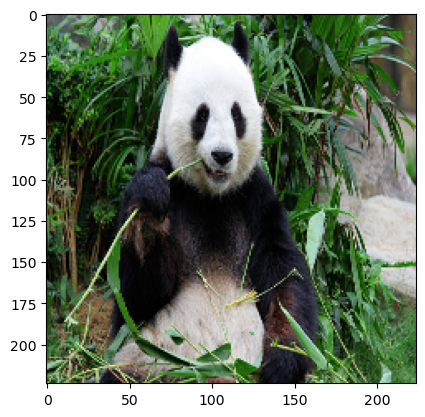

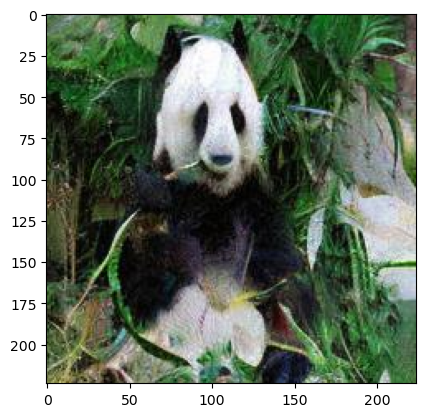

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.50514 | Logit Diff: 0.62403
Label: 264 | Logit Before: 3.17343 | Logit After: 2.04464 | Logit Diff: -1.12879
Label: 428 | Logit Before: 4.07258 | Logit After: 3.40679 | Logit Diff: -0.66578
Label: 190 | Logit Before: 1.40211 | Logit After: 4.29820 | Logit Diff: 2.89609
Average Logit Difference: 0.43139
Positive Percentage: 50.00%
Verification Status: Verified
True
0.4313850998878479
Processing image: epsilon_23.jpg
23
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 43.44it/s]


Finished attacking: epsilon_23.jpg


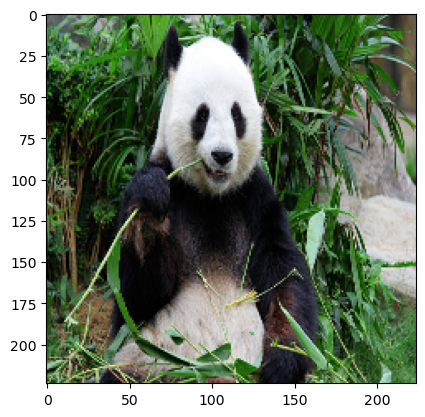

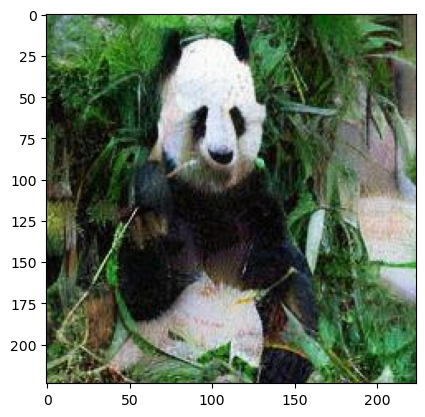

1/1 [==============================] - 0s 80ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.27770 | Logit Diff: -0.14853
Label: 264 | Logit Before: 3.17343 | Logit After: 3.41775 | Logit Diff: 0.24432
Label: 428 | Logit Before: 4.07258 | Logit After: 3.45402 | Logit Diff: -0.61856
Label: 190 | Logit Before: 1.40211 | Logit After: 3.36170 | Logit Diff: 1.95959
Average Logit Difference: 0.35921
Positive Percentage: 50.00%
Verification Status: Verified
True
0.35920512676239014
Processing image: epsilon_18.jpg
18
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 10.75it/s]


Finished attacking: epsilon_18.jpg


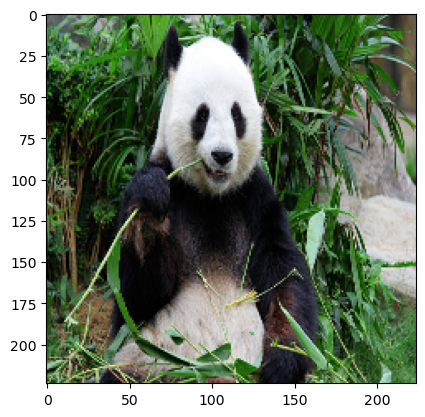

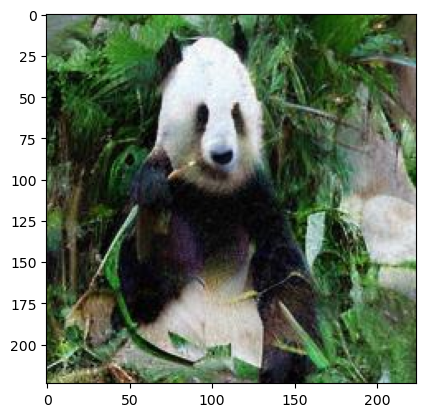

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.06718 | Logit Diff: 1.06198
Label: 264 | Logit Before: 3.17343 | Logit After: 4.39570 | Logit Diff: 1.22227
Label: 428 | Logit Before: 4.07258 | Logit After: 3.60850 | Logit Diff: -0.46408
Label: 190 | Logit Before: 1.40211 | Logit After: 5.20448 | Logit Diff: 3.80237
Average Logit Difference: 1.40564
Positive Percentage: 75.00%
Verification Status: Verified
True
1.4056360721588135
Processing image: epsilon_16.jpg
16
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 14.87it/s]


Finished attacking: epsilon_16.jpg


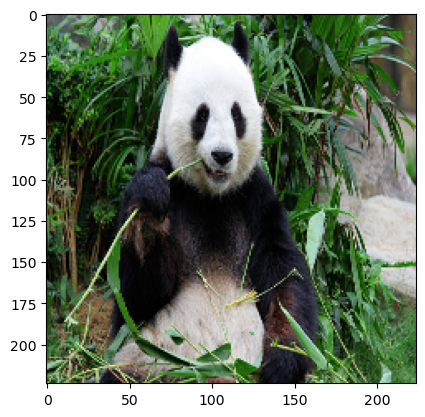

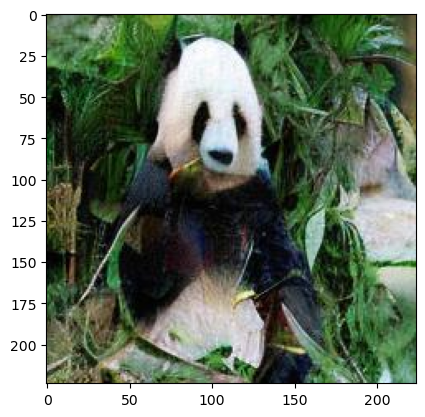

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.36113 | Logit Diff: -0.23196
Label: 264 | Logit Before: 3.17343 | Logit After: 1.68304 | Logit Diff: -1.49040
Label: 428 | Logit Before: 4.07258 | Logit After: 3.00925 | Logit Diff: -1.06333
Label: 190 | Logit Before: 1.40211 | Logit After: 2.90269 | Logit Diff: 1.50058
Average Logit Difference: -0.32128
Positive Percentage: 25.00%
Verification Status: Not Verified
False
-0.3212752938270569
Processing image: epsilon_3.jpg
3
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 103.68it/s]


Finished attacking: epsilon_3.jpg


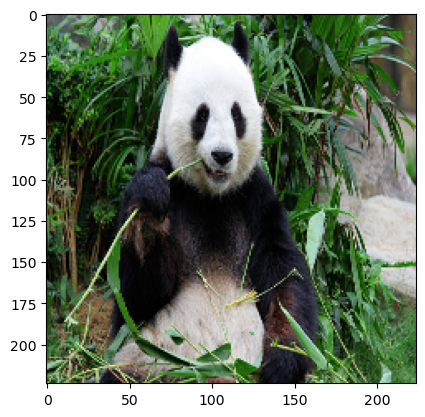

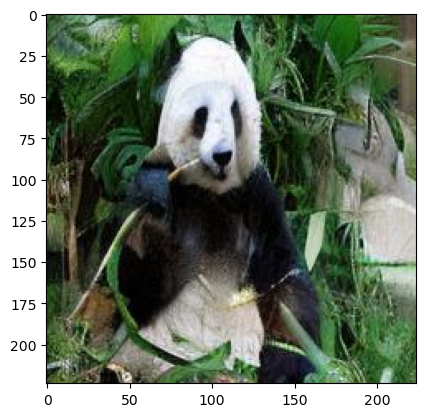

1/1 [==============================] - 0s 42ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.45310 | Logit Diff: 1.67607
Label: 264 | Logit Before: 3.17343 | Logit After: 2.27999 | Logit Diff: -0.89345
Label: 428 | Logit Before: 4.07258 | Logit After: 3.28017 | Logit Diff: -0.79241
Label: 190 | Logit Before: 1.40211 | Logit After: 4.13430 | Logit Diff: 2.73219
Average Logit Difference: 0.68060
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6805993020534515
Processing image: epsilon_11.jpg
11
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 108.48it/s]


Finished attacking: epsilon_11.jpg


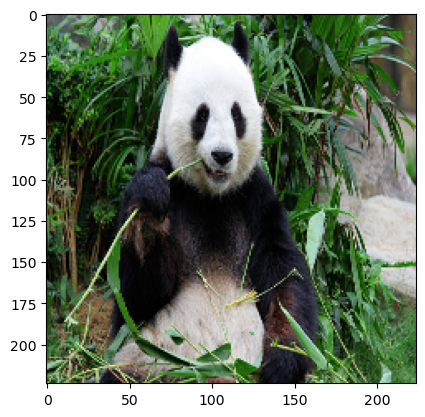

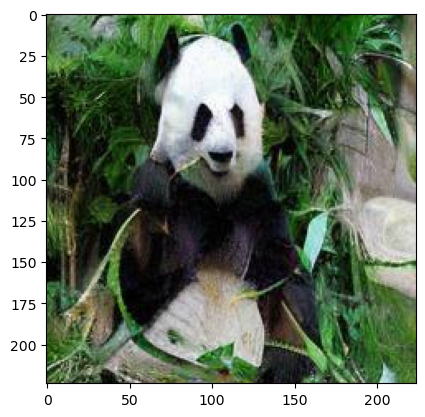

1/1 [==============================] - 0s 33ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.10664 | Logit Diff: 0.02253
Label: 264 | Logit Before: 3.17343 | Logit After: 2.22815 | Logit Diff: -0.94528
Label: 428 | Logit Before: 4.07258 | Logit After: 3.63612 | Logit Diff: -0.43646
Label: 190 | Logit Before: 1.40211 | Logit After: 2.78839 | Logit Diff: 1.38628
Average Logit Difference: 0.00677
Positive Percentage: 50.00%
Verification Status: Verified
True
0.00676804780960083
Processing image: epsilon_4.jpg
4
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 25.27it/s]


Finished attacking: epsilon_4.jpg


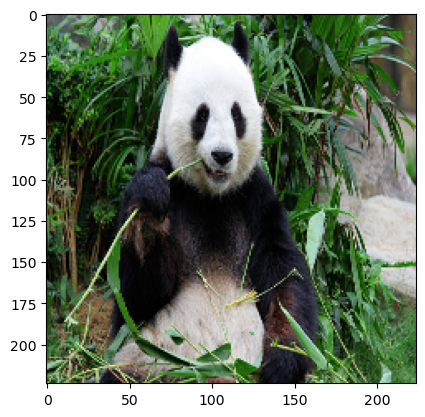

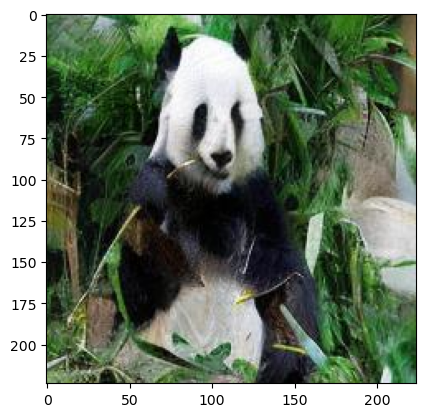

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.25212 | Logit Diff: 0.87705
Label: 264 | Logit Before: 3.17343 | Logit After: 3.69507 | Logit Diff: 0.52164
Label: 428 | Logit Before: 4.07258 | Logit After: 4.18368 | Logit Diff: 0.11110
Label: 190 | Logit Before: 1.40211 | Logit After: 4.41370 | Logit Diff: 3.01159
Average Logit Difference: 1.13034
Positive Percentage: 100.00%
Verification Status: Verified
True
1.1303434371948242
Processing image: epsilon_34.jpg
34
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 94.78it/s]


Finished attacking: epsilon_34.jpg


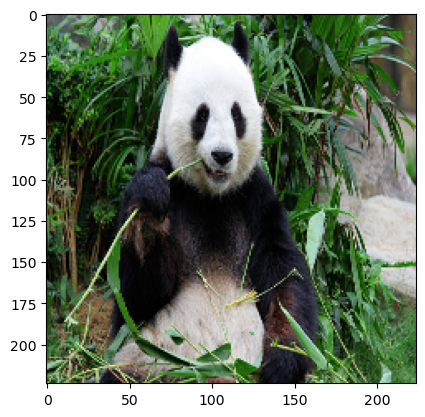

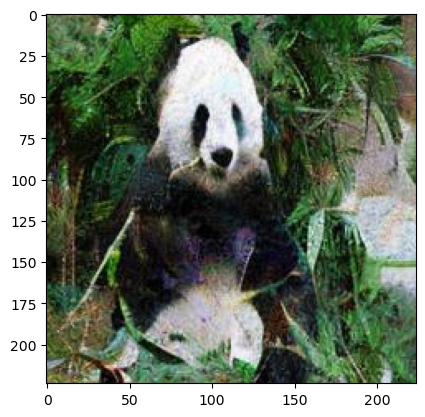

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.31922 | Logit Diff: 0.80995
Label: 264 | Logit Before: 3.17343 | Logit After: 3.33845 | Logit Diff: 0.16502
Label: 428 | Logit Before: 4.07258 | Logit After: 3.82667 | Logit Diff: -0.24591
Label: 190 | Logit Before: 1.40211 | Logit After: 4.86051 | Logit Diff: 3.45840
Average Logit Difference: 1.04686
Positive Percentage: 75.00%
Verification Status: Verified
True
1.0468626618385315
Processing image: epsilon_33.jpg
33
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 101.30it/s]


Finished attacking: epsilon_33.jpg


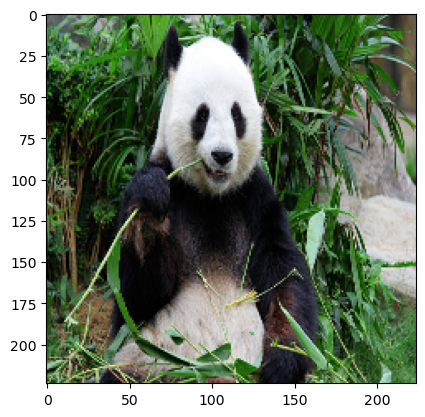

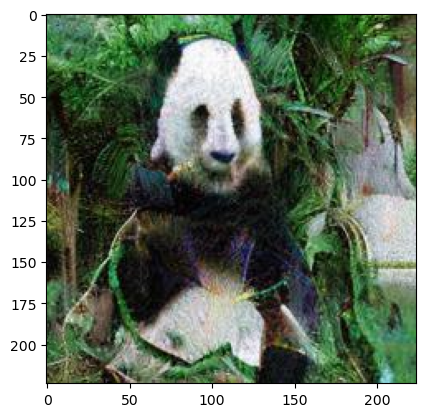

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.01164 | Logit Diff: 1.11753
Label: 264 | Logit Before: 3.17343 | Logit After: 2.54850 | Logit Diff: -0.62494
Label: 428 | Logit Before: 4.07258 | Logit After: 3.33364 | Logit Diff: -0.73894
Label: 190 | Logit Before: 1.40211 | Logit After: 4.04561 | Logit Diff: 2.64350
Average Logit Difference: 0.59929
Positive Percentage: 50.00%
Verification Status: Verified
True
0.5992896556854248
Processing image: epsilon_10.jpg
10
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 106.46it/s]


Finished attacking: epsilon_10.jpg


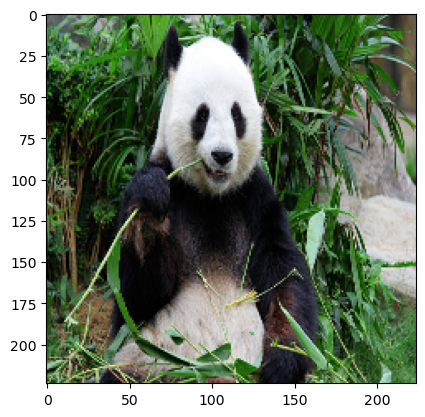

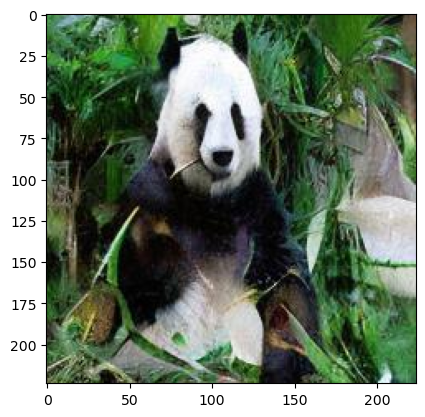

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.34099 | Logit Diff: 1.78818
Label: 264 | Logit Before: 3.17343 | Logit After: 3.52111 | Logit Diff: 0.34768
Label: 428 | Logit Before: 4.07258 | Logit After: 4.18152 | Logit Diff: 0.10894
Label: 190 | Logit Before: 1.40211 | Logit After: 4.05594 | Logit Diff: 2.65383
Average Logit Difference: 1.22466
Positive Percentage: 100.00%
Verification Status: Verified
True
1.224656492471695
Processing image: epsilon_5.jpg
5
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 30.29it/s]


Finished attacking: epsilon_5.jpg


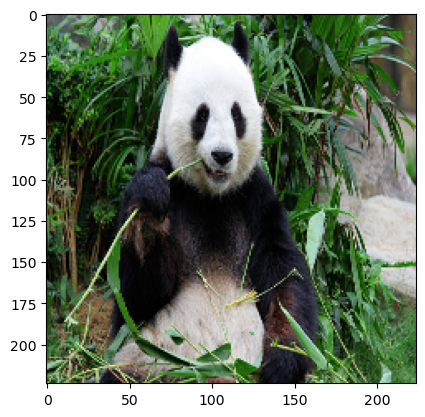

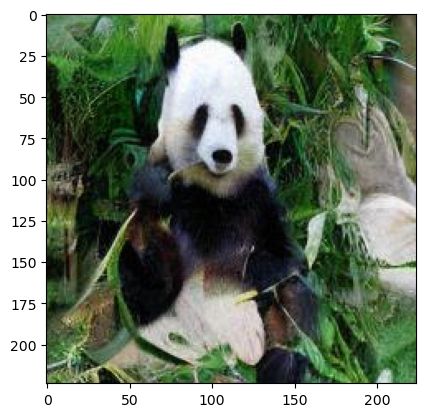

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.67875 | Logit Diff: 1.45042
Label: 264 | Logit Before: 3.17343 | Logit After: 2.50654 | Logit Diff: -0.66689
Label: 428 | Logit Before: 4.07258 | Logit After: 2.45959 | Logit Diff: -1.61298
Label: 190 | Logit Before: 1.40211 | Logit After: 4.79345 | Logit Diff: 3.39134
Average Logit Difference: 0.64047
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6404699385166168
Processing image: epsilon_17.jpg
17
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 98.50it/s]


Finished attacking: epsilon_17.jpg


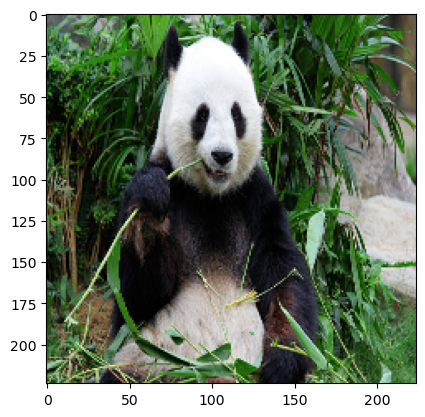

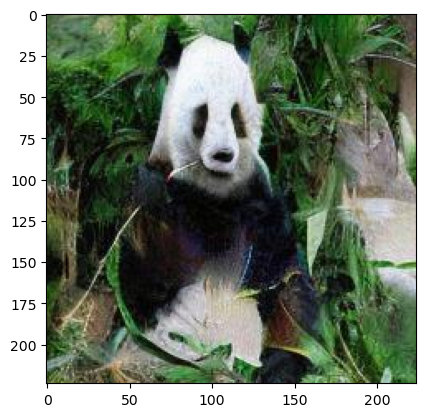

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.55877 | Logit Diff: 1.57040
Label: 264 | Logit Before: 3.17343 | Logit After: 2.18960 | Logit Diff: -0.98383
Label: 428 | Logit Before: 4.07258 | Logit After: 2.86009 | Logit Diff: -1.21249
Label: 190 | Logit Before: 1.40211 | Logit After: 3.61825 | Logit Diff: 2.21614
Average Logit Difference: 0.39756
Positive Percentage: 50.00%
Verification Status: Verified
True
0.39755573868751526
Processing image: epsilon_2.jpg
2
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 102.62it/s]


Finished attacking: epsilon_2.jpg


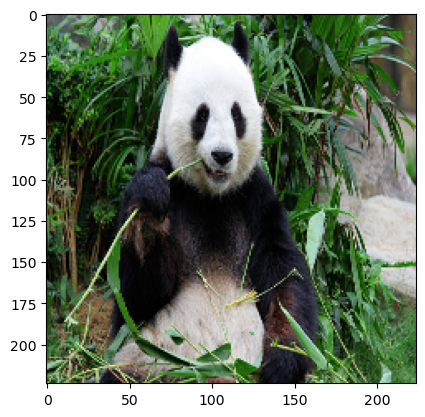

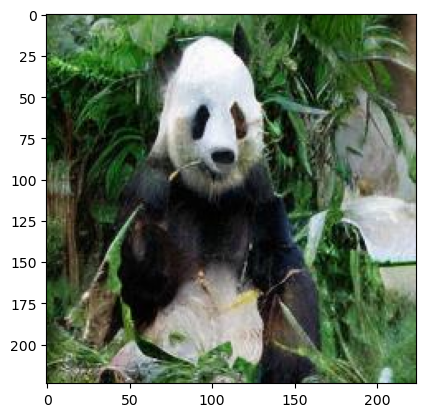

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.53493 | Logit Diff: 1.59424
Label: 264 | Logit Before: 3.17343 | Logit After: 4.80129 | Logit Diff: 1.62786
Label: 428 | Logit Before: 4.07258 | Logit After: 4.24173 | Logit Diff: 0.16916
Label: 190 | Logit Before: 1.40211 | Logit After: 5.80555 | Logit Diff: 4.40344
Average Logit Difference: 1.94867
Positive Percentage: 100.00%
Verification Status: Verified
True
1.948674887418747
Processing image: epsilon_19.jpg
19
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 110.10it/s]


Finished attacking: epsilon_19.jpg


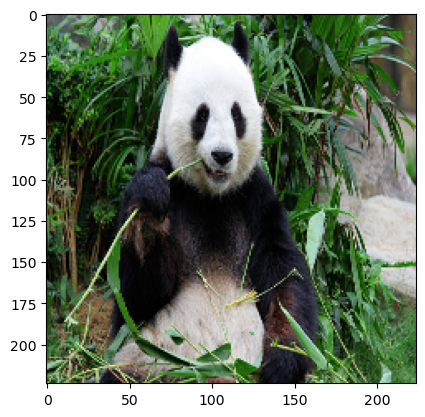

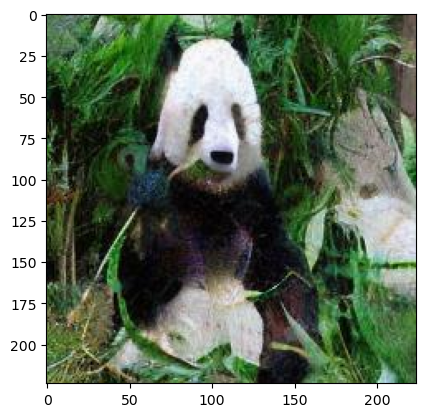

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.65616 | Logit Diff: 1.47301
Label: 264 | Logit Before: 3.17343 | Logit After: 3.41599 | Logit Diff: 0.24255
Label: 428 | Logit Before: 4.07258 | Logit After: 3.49026 | Logit Diff: -0.58231
Label: 190 | Logit Before: 1.40211 | Logit After: 4.44591 | Logit Diff: 3.04380
Average Logit Difference: 1.04426
Positive Percentage: 75.00%
Verification Status: Verified
True
1.0442621409893036
Processing image: epsilon_22.jpg
22
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 78.34it/s]


Finished attacking: epsilon_22.jpg


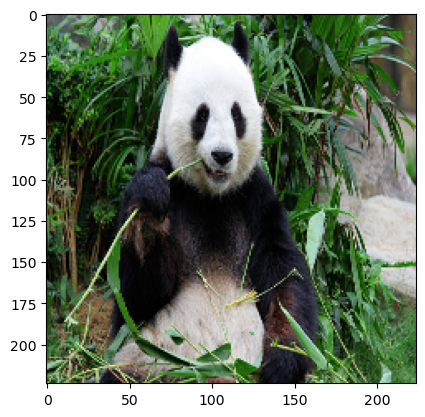

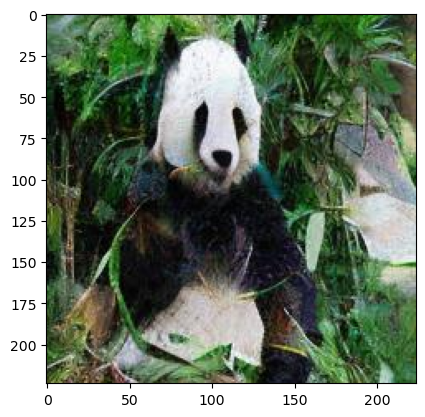

1/1 [==============================] - 0s 34ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.56951 | Logit Diff: 0.55966
Label: 264 | Logit Before: 3.17343 | Logit After: 1.43290 | Logit Diff: -1.74053
Label: 428 | Logit Before: 4.07258 | Logit After: 3.14217 | Logit Diff: -0.93041
Label: 190 | Logit Before: 1.40211 | Logit After: 3.90527 | Logit Diff: 2.50316
Average Logit Difference: 0.09797
Positive Percentage: 50.00%
Verification Status: Verified
True
0.0979691743850708
Processing image: epsilon_25.jpg
25
**************************************************
Attacking PGD WhiteBox Watermark with diff_attacker_60


1it [00:00, 96.20it/s]


Finished attacking: epsilon_25.jpg


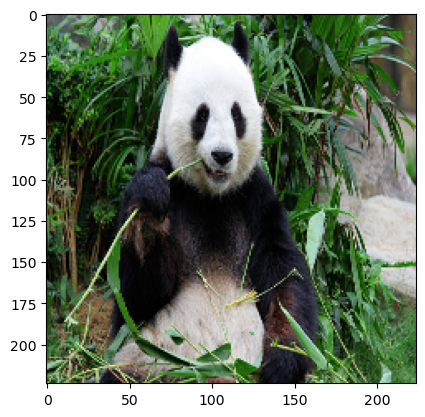

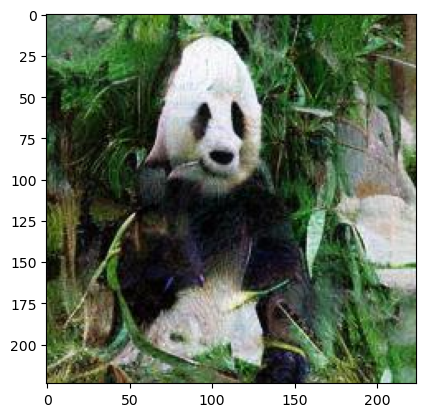

1/1 [==============================] - 0s 35ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.48548 | Logit Diff: 1.64369
Label: 264 | Logit Before: 3.17343 | Logit After: 2.65925 | Logit Diff: -0.51418
Label: 428 | Logit Before: 4.07258 | Logit After: 3.72504 | Logit Diff: -0.34754
Label: 190 | Logit Before: 1.40211 | Logit After: 3.24703 | Logit Diff: 1.84492
Average Logit Difference: 0.65672
Positive Percentage: 50.00%
Verification Status: Verified
True
0.6567224264144897


In [13]:
import os
import cv2
from PIL import Image
logit_diffs_dic = {}
# Directory where the images are stored
image_dir = "../output/blackbox_epsilon_testing"

# Get a list of all images in the directory
image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]  # Modify for other extensions if needed

# Make sure there are images to process
if not image_files:
    print("No images found in the directory.")
else:
    # Iterate over each image file
    
    for image_file in os.listdir(image_dir):
        # Construct the full image path
        image_path = os.path.join(image_dir, image_file)
        
        print(f"Processing image: {image_file}")

        watermarked_img_path = image_path
        index = image_file.index(".")
        print(image_file[8:index])
        attacked_img_path = f"./output/black_box_attacked_images/perturbed_panda_attacked{image_file[8:index]}.jpg"
        
        
        image = Image.open(watermarked_img_path).convert("RGB")
        
        attacker_name = "diff_attacker_60"
        attacker = attackers[attacker_name]   # Select the attacker
        
        print('*' * print_width)
        print(f'Attacking PGD WhiteBox Watermark with {attacker_name}')
        
        
        # Move attacker model to CUDA if available
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        attacker.pipe.to(device)  # Ensure the model is on the right device
        
        # Apply the attack
        attacker.attack([watermarked_img_path], [attacked_img_path])
        
        print(f'Finished attacking: {image_file}')

        original_image_path = "examples/panda.jpg"
        sample_image_org = show_image(original_image_path)
        preprocessed_image_org = preprocess_image(sample_image_org)
        image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)
        
        sample_image_att = show_image(attacked_img_path)
        preprocessed_image = preprocess_image(sample_image_att)
        image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)
        
        original_logits = resnet50.predict(preprocess_input(image_tensor_org))
        attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

        verif, avg_diff = verify_watermark(original_logits, attacked_logits,
                 [726, 264, 428, 190])
        print(verif)
        print(avg_diff)
        dic_key = int(image_file[8:index])
        logit_diffs_dic[dic_key] = avg_diff
        
      


In [14]:
sorted_logit_diffs_dic = {key: logit_diffs_dic[key] for key in sorted(logit_diffs_dic)}
epsilon_values = np.arange(0, 4/255, 0.1/255)


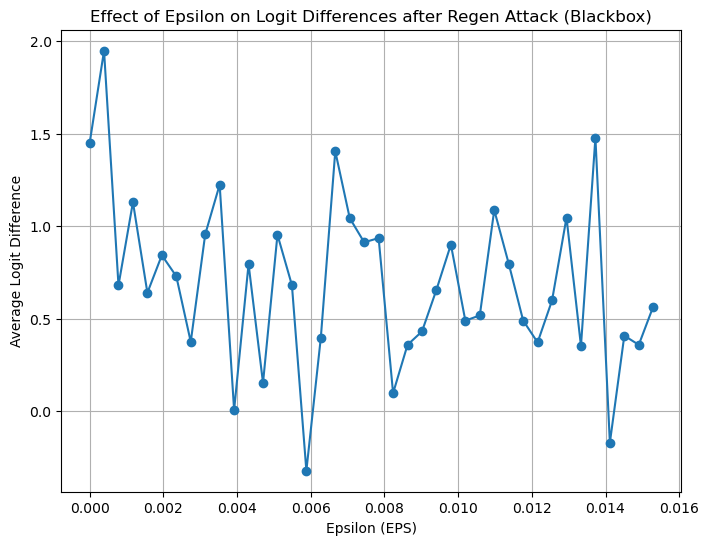

In [17]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.plot(epsilon_values, sorted_logit_diffs_dic.values(), marker='o', linestyle='-')
plt.xlabel("Epsilon (EPS)")
plt.ylabel("Average Logit Difference")
plt.title("Effect of Epsilon on Logit Differences after Regen Attack (Blackbox)")
plt.grid(True)
plt.savefig("./output/logit_diff_vs_epsilon.png")

plt.show()

Diffuse attack initialized with noise step 0 and use prompt 0


1it [00:00, 13.72it/s]


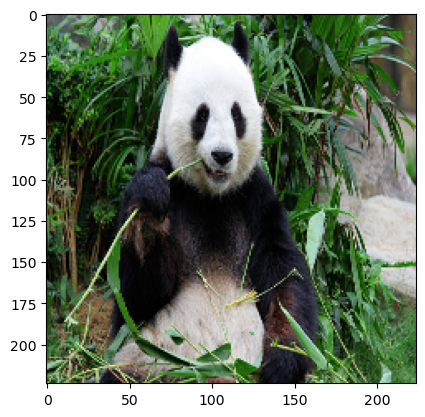

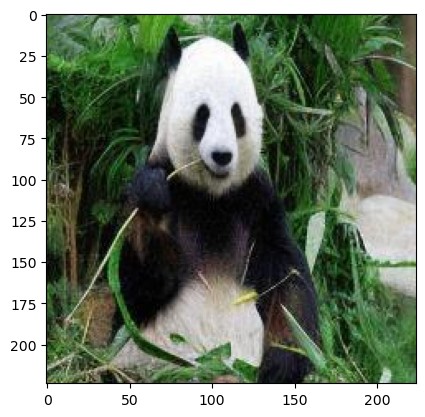

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.26403 | Logit Diff: 1.86514
Label: 264 | Logit Before: 3.17343 | Logit After: 2.98368 | Logit Diff: -0.18975
Label: 428 | Logit Before: 4.07258 | Logit After: 2.96252 | Logit Diff: -1.11006
Label: 190 | Logit Before: 1.40211 | Logit After: 3.92108 | Logit Diff: 2.51897
Average Logit Difference: 0.77108
Positive Percentage: 50.00%
Verification Status: Verified
True 0.7710759341716766
Diffuse attack initialized with noise step 20 and use prompt 0


1it [00:00,  1.68it/s]


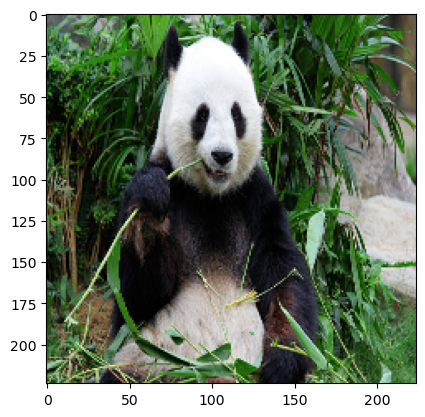

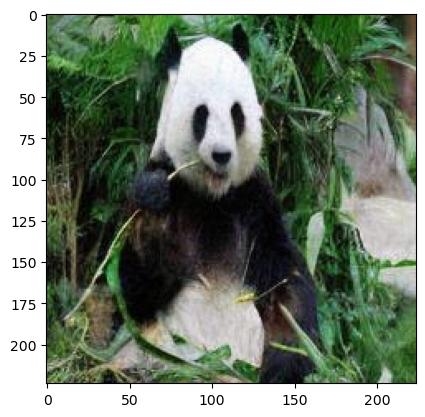

1/1 [==============================] - 0s 36ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.76188 | Logit Diff: 1.36729
Label: 264 | Logit Before: 3.17343 | Logit After: 3.24232 | Logit Diff: 0.06889
Label: 428 | Logit Before: 4.07258 | Logit After: 2.68301 | Logit Diff: -1.38957
Label: 190 | Logit Before: 1.40211 | Logit After: 5.01310 | Logit Diff: 3.61099
Average Logit Difference: 0.91440
Positive Percentage: 75.00%
Verification Status: Verified
True 0.914398580789566
Diffuse attack initialized with noise step 40 and use prompt 0


1it [00:00,  1.65it/s]


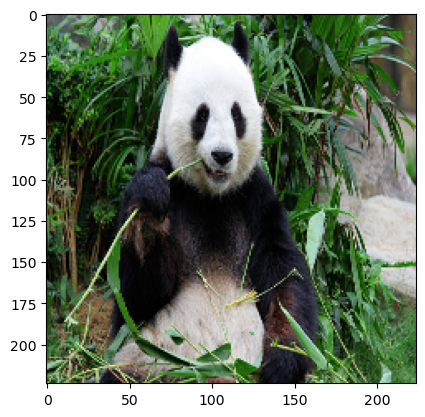

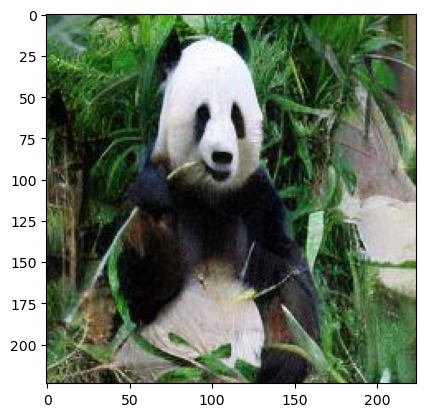

1/1 [==============================] - 0s 38ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -2.41508 | Logit Diff: 0.71409
Label: 264 | Logit Before: 3.17343 | Logit After: 3.71200 | Logit Diff: 0.53857
Label: 428 | Logit Before: 4.07258 | Logit After: 2.86106 | Logit Diff: -1.21152
Label: 190 | Logit Before: 1.40211 | Logit After: 2.64553 | Logit Diff: 1.24342
Average Logit Difference: 0.32114
Positive Percentage: 75.00%
Verification Status: Verified
True 0.321140855550766
Diffuse attack initialized with noise step 80 and use prompt 0


1it [00:00,  1.66it/s]


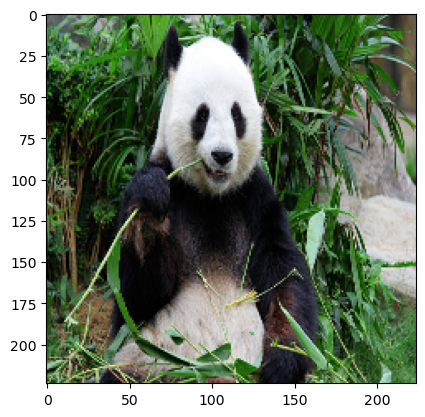

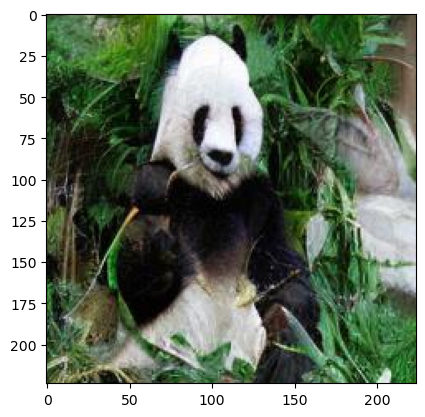

1/1 [==============================] - 0s 41ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -1.48704 | Logit Diff: 1.64213
Label: 264 | Logit Before: 3.17343 | Logit After: 2.95753 | Logit Diff: -0.21590
Label: 428 | Logit Before: 4.07258 | Logit After: 3.63081 | Logit Diff: -0.44177
Label: 190 | Logit Before: 1.40211 | Logit After: 3.25598 | Logit Diff: 1.85387
Average Logit Difference: 0.70958
Positive Percentage: 50.00%
Verification Status: Verified
True 0.7095822691917419
Diffuse attack initialized with noise step 160 and use prompt 0


1it [00:00,  1.99it/s]


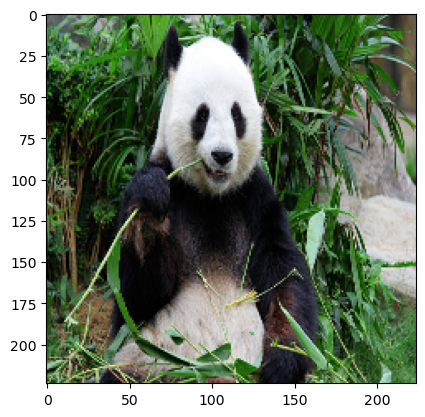

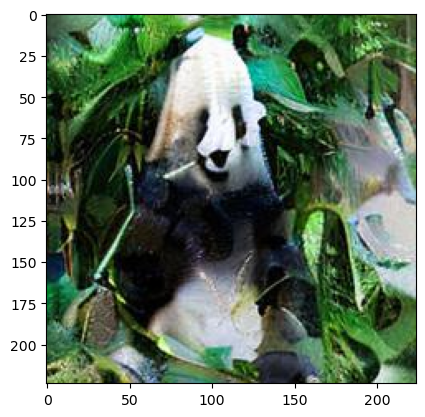

1/1 [==============================] - 0s 37ms/step
Label: 726 | Logit Before: -3.12917 | Logit After: -3.21788 | Logit Diff: -0.08871
Label: 264 | Logit Before: 3.17343 | Logit After: 1.66808 | Logit Diff: -1.50536
Label: 428 | Logit Before: 4.07258 | Logit After: 2.08485 | Logit Diff: -1.98773
Label: 190 | Logit Before: 1.40211 | Logit After: -1.38729 | Logit Diff: -2.78940
Average Logit Difference: -1.59280
Positive Percentage: 0.00%
Verification Status: Not Verified
False -1.5928011536598206


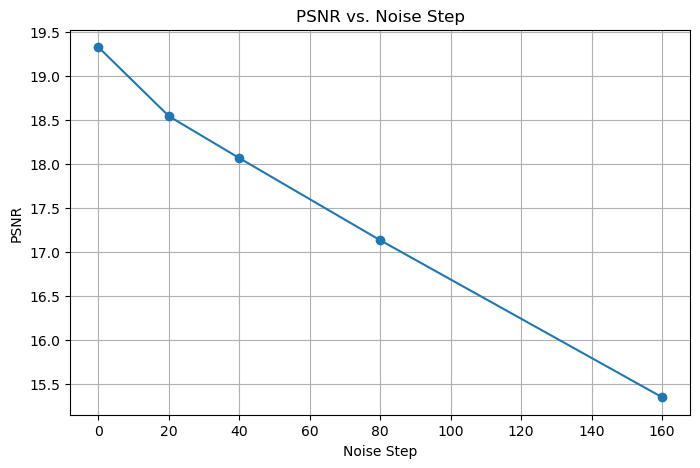

In [13]:

# Define different noise step values
noise_steps = [0, 20, 40, 80, 160]
psnr_values = []
watermarked_img_path = "../output/blackbox_epsilon_testing/epsilon_7.jpg"
secret_labels = [726, 264, 428, 190]
# Run attack for each noise step
for step in noise_steps:
    attacker = DiffWMAttacker(pipe, batch_size=5, noise_step=step, captions={})
    attacked_img_path = f"./output/blackbox_eps7_attacked_{step}.jpg"
    attacker.attack([watermarked_img_path], [attacked_img_path])

    sample_image_org = show_image(original_image_path)
    preprocessed_image_org = preprocess_image(sample_image_org)
    image_tensor_org = tf.constant(preprocessed_image_org, dtype=tf.float32)
    
    sample_image_att = show_image(attacked_img_path)
    preprocessed_image = preprocess_image(sample_image_att)
    image_tensor_att = tf.constant(preprocessed_image, dtype=tf.float32)
    
    original_logits = resnet50.predict(preprocess_input(image_tensor_org))
    attacked_logits = resnet50.predict(preprocess_input(image_tensor_att))

    verified, avg_diff = verify_watermark(original_logits, attacked_logits,
                secret_labels )
    print(verified, avg_diff)

    # Compute PSNR
    psnr, _, _ = eval_psnr_ssim_msssim("../output/preprocessed_image.png", attacked_img_path)
    psnr_values.append(psnr)

# Plot PSNR vs. Noise Step
plt.figure(figsize=(8, 5))
plt.plot(noise_steps, psnr_values, marker='o', linestyle='-')
plt.xlabel("Noise Step")
plt.ylabel("PSNR")
plt.title("PSNR vs. Noise Step")
plt.grid()
plt.show()